# Folium y Wordcloud - Datos Espaciales y de texto

## Taller **Evaluado**.

**Profesor:** Hernán Valdivieso.

**Ayudantes**: Francisca Ibarra y Pablo Araneda.


---

El siguiente _jupyter notebook_ tiene como fin ser una guía de cómo utilizar la librería de Python [Folium](https://python-visualization.github.io/folium/quickstart.html) y [Wordcloud](https://amueller.github.io/word_cloud/auto_examples/index.html) para:

1. Explorar algunos _datasets_ de interés: [NYC Taxi Fare](https://www.kaggle.com/code/breemen/nyc-taxi-fare-data-exploration/data), [House Price Prediction Challenge](https://www.kaggle.com/datasets/anmolkumar/house-price-prediction-challenge) y [Spanish Arilines Tweets Sentiment Analysis](https://www.kaggle.com/competitions/spanish-arilines-tweets-sentiment-analysis/).

2. Construir visualizaciones que aporten a explorar los resultados obtenidos tras utilizar un modelo de _machine learning_ en los _datasets_ anteriormente mencionados.

Para facilitar la instalación de esta librería, este archivo fue entregado en un [Google Colab](https://colab.research.google.com/) para poder ejecutarlo en los servidores de Google, los cuales ya disponen de todos los recursos necesarios para ejecutar los códigos que implementarás y únicamente requerirá de internet para trabajar con este archivo.


Este _jupyter notebook_ se compone de 7 actividades, las cuales se dividen en 3 partes:

1. Entregar ejemplos y confeccionar algunas visualizaciones espaciales con el _dataset_ de NYC Taxi Fare. (1 actividad).

2. Confeccionar algunas visualizaciones espaciales con el _dataset_ de House Price Prediction Challenge. (3 actividades).

1. Entregar ejemplos, confeccionar algunas visualizaciones de texto (wordcloud específicamente) con el _dataset_ de Spanish Arilines Tweets Sentiment Analysis y comentar lo observado. (3 actividades).


Cada actividad **puede ponderar distinto**, es decir, no asuman que cada actividad presentará el mismo puntaje.

---

En caso de hacer el práctico en parejas, **solo 1 debe entregar o se aplicará un descuento de 10 décimas**. Tienen hasta el **viernes 18 de Octubre 23:59 para entregar**, luego se aplicará un descuento de hasta 10 décimas por entregas de atraso. Solo se acepta hasta 24 horas de atraso.

Adicionalmente, **solo se acepta 1 respuesta/visualización por ejercicio. En caso de entregar más de una respuesta, se revisará la primera.**

Indique aquí los integrantes:
- `Sebastian Latorre (seba.latorre.diaz@gmail.com)`

## Instalar/Actualizar e importar librerías del taller

In [ ]:
!pip install folium -q
!pip install wordcloud==1.9.1.1 -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 4.8 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import folium
import random
import string
import nltk
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import colors
from nltk.corpus import stopwords
from datetime import datetime
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator, get_single_color_func
from folium import plugins
import requests
from IPython.display import display, HTML
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC

## Descargar _dataset_

En primero lugar, como estaremos ocupando un servidor externo, es necesario descargar los _datasets_ en dicho servidor. Para esto ocuparemos una función encargada de bajar un archivo desde Google Drive.

In [ ]:
def download_file_without_authenticate(id, destination):
    def get_confirm_token(response):
        for key, value in response.cookies.items():
            if key.startswith("download_warning"):
                return value

    URL = "https://docs.google.com/uc?export=download"
    response = requests.get(URL, params={"id": id, "confirm": 1}, stream=True)

    CHUNK_SIZE = 32768
    with open(destination, "wb") as f:
        for i, chunk in enumerate(response.iter_content(CHUNK_SIZE)):
            if chunk:  # filter out keep-alive new chunks
                f.write(chunk)

    return None

download_file_without_authenticate("1MFTzyzGpqRkuINRmZ3nxAJxbE7VA1A4j", "taller-folium-wordcloud.zip")
!unzip -o -q taller-folium-wordcloud.zip

In [ ]:
!ls

'House Price Prediction.csv'		 sample_data		      'Tweets Public.csv'
'New York City Taxi Fare (Sample).csv'	 taller-folium-wordcloud.zip


# Caso 1 - New York City Taxi Fare

In [ ]:
df_nyc = pd.read_csv("New York City Taxi Fare (Sample).csv")
df_nyc.sample(5)

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance
55811,2015-06-20 18:32:45.0000001,14.0,2015-06-20 18:32:45 UTC,-73.983246,40.762321,-74.002853,40.760536,1,1.667446
80846,2014-01-06 14:01:00.000000158,4.0,2014-01-06 14:01:00 UTC,-73.989707,40.734322,-73.999267,40.738350,2,0.923138
169738,2009-12-14 18:00:23.0000002,6.1,2009-12-14 18:00:23 UTC,-73.980683,40.745010,-73.992274,40.730700,1,1.866503
125425,2014-07-04 18:11:00.00000064,15.0,2014-07-04 18:11:00 UTC,-74.004412,40.742077,-74.008607,40.704590,1,4.177938
158052,2011-10-07 09:09:18.0000001,5.7,2011-10-07 09:09:18 UTC,-73.981009,40.748467,-73.976551,40.739593,1,1.054930


In [ ]:
df_nyc.shape

(196102, 9)

## Mapa de la visualización ([Map](https://python-visualization.github.io/folium/latest/reference.html#module-folium.folium))

Antes de empezar a construir las visualizaciones. Vamos a interactuar con el mapa.

In [ ]:
f_map = folium.Map(width=800, height=400)

f_map.save("output.html")
display(HTML('output.html'))

**Explicación del código**

- **Crear mapa**

  ```python
f_map = folium.Map(width=800, height=400)
  ```
En esta línea estamos creando un objeto [`Map`](https://python-visualization.github.io/folium/latest/reference.html#module-folium.folium) el cual contiene la información del mapa del mundo. Este mapa lo creamos únicamente con 2 parámetros, el ancho (`width`) y largo (`height`).

- **Guardar y mostrar el mapa**

  ```python
f_map.save("output.html")
display(HTML('output.html'))
 ```
En estas 2 líneas le indicamos al mapa que guarde todo en un archivo HTML llamado `output.html`. Luego, usamos la función `HTML` para abrir ese archvo y la función `display` para decirle a colab que despliegue el mapa.  
  **Importante**: esto solo funciona cuando al mapa le asignamos un tamaño (`width` y `height`). En otro caso, no se verá el mapa.

---
---



Ahora vamos a personalizar mucho más el mapa.


In [ ]:
f_map = folium.Map(location=[40.76, -73.99], zoom_start=12,
                   min_zoom=9, max_zoom=12, zoom_control=False,
                   tiles="Cartodbdark_matter", prefer_canvas=True)
f_map

**Explicación del código**

- **Crear mapa**

  ```python
f_map = folium.Map(location=[40.76, -73.99], zoom_start=12,
                     min_zoom=9, max_zoom=12, zoom_control=False,
                     tiles="Cartodbdark_matter", prefer_canvas=True)
```
En esta línea estamos creando un mapa con 7 nuevos parámetros:
  1. `location`: es una lista con el formato `[latitud, longitud]` y permite indicar desde qué lugar del mundo inicializar el mapa.
  2. `zoom_start`: indica el nivel de *zoom* a realizar al mapa. A mayor valor, mayor es el *zoom* inicial.
  3. `min_zoom`: indica que tan lejos puedes llegar con el *zoom*.
  4. `max_zoom`: indica que tan cerca puedes llegar con el *zoom*.
  5. `zoom_control`: indica si queremos ver los botones `+` y `-`en el mapa para acercarse o alejarse. Por defecto es `True`, pero ahora lo dejamos el `False` para sacarlo.
  6. `tiles`: indica que tipo de mapa poner de fondo.
  7. `prefer_canvas`: indica si queremos intentar usar canvas con el mapa o no. Canvas es un medio de hacer visualizaciones que soporta una gran cantidad de datos encima.

- **Mostrar el mapa (sin guardar)**

  ```python
f_map
  ```
Cuando ponemos la variable `f_map` en la última línea del código. Por defecto se desplegará este. No obstante, el tamaño de la ventana que contiene el mapa es fijo. En consecuencia, si ponemos que `height` es 400, vamos achicamos el mapa, pero no la ventana, lo que generará un espacio en blanco debajo del mapa. En la siguiente celda veremos un ejemplo donde definimos un tamaño, pero usamos `f_map`.

  **Recomendación**: Si se define `width` y `height` entonces usar la versión de guardar el mapa y visualizarlo con `display(HTML(...))`. En caso de no definir esos valores, poner la variable que guarda el mapa en la última línea de la celda.

In [ ]:
f_map = folium.Map(location=[40.76, -73.99], width=800, height=400)

f_map

**Explicación del código**

- **Crear el mapa**

  ```python
f_map = folium.Map(location=[40.76, -73.99], width=800, height=400)
  ````

  En este caso definimos un tamaño al mapa, por lo tanto, se generó ese espacio en blanco mencionado anteriormente.

## Mapa de Flujo - ([PolyLine](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.PolyLine))

Ahora vamos con la primera visualización. Queremos observar algunas rutas del mapa para saber cuál era el flujo de movimiento. Notar que aquí solo tenemos posición de inicio y final, así que veremos solo líneas rectas.

In [ ]:
f_map = folium.Map(location=[40.76, -73.99], zoom_start=11,
                   tiles="Cartodbdark_matter", width=600, height=400)

for row in df_nyc.head(20).iterrows():
    data = row[1]
    rute = [
            [data.pickup_latitude, data.pickup_longitude],
            [data.dropoff_latitude, data.dropoff_longitude]
            ]

    popup_text = "Costo: {} dólares".format(data.fare_amount)
    tooltip_text = "Pasajeros: {} - Fecha: {}".format(data.passenger_count, data.pickup_datetime)
    rute_line = folium.PolyLine(locations=rute, weight=5, color="red", popup=popup_text, tooltip=tooltip_text)
    f_map.add_child(rute_line)

f_map.save("output.html")
display(HTML('output.html'))

**Explicación del código**

- **Obtener rutas del dataset**
```python
for row in df_nyc.head(20).iterrows():
      data = row[1]
      rute = [
              [data.pickup_latitude, data.pickup_longitude],
              [data.dropoff_latitude, data.dropoff_longitude]
              ]
```

  En primer lugar, usamos el método `head(20)` para obtener solo las primeras 20 rutas. Luego usamos `iterrows()` para poder aplicar un `for` a esos datos. `iterrows` por defecto devuelve simultáneamente índice de la fila y los datos de la fila. Por este motivo hacemos `data = row[1]` porque `row[0]` corresponde al índice de la fila.

  Finalmente, creamos una lista con las posiciones. En este caso, la lista tiene el siguiente formato:

  `[latitud_inicio, longitud_inicio], [latitud_fin, longitud_fin]`

  Esta lista se puede llenar con más datos para generar uniones de múltiples rectas.


- **Crear rutas en el mapa**

  ```python
popup_text = "Costo: {} dólares".format(row.fare_amount)
tooltip_text = "Pasajeros: {} - Fecha: {}".format(row.passenger_count, row.pickup_datetime)
  ```
Primero construimos un texto con el costo del viaje. Aquí usamos `format` para indicar que debe reemplazar las llaves (`{}`) por el dato de `row.fare_amount`. Luego creamos otro texto con la cantidad de pasajes y la fecha del viaje. Dado que tenemos 2 llaves, en `format` debemos agregar 2 datos.

  ```python
rute_line = folium.PolyLine(locations=rute, weight=5, color="red", popup=popup, tooltip=tooltip)
f_map.add_child(rute_line)
  ```
Utilizamos [`folium.PolyLine`](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.PolyLine) para indicar que queremos construir una línea. Le entregamos la lista construida anteriormente para que `folium` se encargue de unir los puntos mediante una recta. Adicionalmente, personalizamos la línea con:
  - `weight`: para indicar el ancho de la línea.
  - `color`: para indicar el color de la línea.
  - `popup`: para indicar qué texto mostrar cuando uno presiona una línea con el cursor.
  - `tooltip`: para indicar qué texto mostrar cuando el cursor pase por encima de una línea.

### Actividad 1 - gráfico de flujo

Complete la siguiente función para construir un **gráfico con flujo** considerando únicamente los viajes de 2 pasajeros que costaron más de 20 dólares. Además, configure el gráfico del siguiente modo:

1. El mapa debe partir con un *zoom* de 7 y máximo puede llegar a un *zoom* de 10.
2. Las líneas deben ser pintadas de un color distinto al utilizado en el ejemplo anterior.
3. El grosor de las líneas debe ser de valor 2.

Un ejemplo del gráfico resultante es:

![](https://res.cloudinary.com/hernan4444/image/upload/v1679869764/Diplomado/ML/Taller_4_-_flujo.png)

In [ ]:
# # Debes completar la función crear_mapa_flujo con lo solicitado.

# def crear_mapa_flujo(dataset):

#     # Actualizar Zoom
#     f_map = folium.Map(location=[40.76, -73.99], tiles="Cartodbdark_matter",
#                        width=600, height=400, )

#     # Filtrar datos
#     df_filtered = dataset

#     # Obtener rutas
#     for index, row in df_filtered.iterrows():
#         rute = [[row.pickup_latitude, row.pickup_longitude],
#                 [row.dropoff_latitude, row.dropoff_longitude]]

#         # Agregar rutas al mapa por cada iteración, Definir color y grosor
#         rute_line = folium.PolyLine()
#         f_map.add_child(rute_line)

#     # Guardar y ver mapa - NO TOCAR
#     f_map.save("output.html")
#     display(HTML('output.html'))

# crear_mapa_flujo(df_nyc)

In [ ]:
import folium
from IPython.display import display, HTML

def crear_mapa_flujo(dataset):
    # Filtrar viajes con 2 pasajeros y costo mayor a 20 dólares
    df_filtered = dataset[(dataset['passenger_count'] == 2) & (dataset['fare_amount'] > 20)]

    # Crear el mapa con zoom inicial de 7 y límite de zoom máximo 10
    f_map = folium.Map(location=[40.76, -73.99], tiles="Cartodbdark_matter",
                       zoom_start=7, max_zoom=10, width=600, height=400)

    # Obtener rutas y agregar al mapa
    for index, row in df_filtered.iterrows():
        rute = [[row.pickup_latitude, row.pickup_longitude],
                [row.dropoff_latitude, row.dropoff_longitude]]

        # Definir líneas de color distinto y grosor 2
        rute_line = folium.PolyLine(locations=rute, color='blue', weight=2)
        f_map.add_child(rute_line)

    # Guardar y mostrar el mapa
    f_map.save("output.html")
    display(HTML('output.html'))

# Llamar a la función con tu dataset
crear_mapa_flujo(df_nyc)


Habrás notado en la imagen de ejemplo o en la visualización creada que hay algunas líneas extrañas. ¿Por qué pasa eso?  Exploremos aquellas rutas sobre 1000 km.

In [ ]:
df_nyc[df_nyc.distance > 1000].head()

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance
4231,2014-03-27 18:01:00.00000071,21.50,2014-03-27 18:01:00 UTC,-74.001808,40.750782,0.0,0.000000,1,8667.839888
6235,2012-10-31 14:37:00.00000046,2.50,2012-10-31 14:37:00 UTC,-73.929230,40.744627,0.0,0.000000,5,8661.688163
6373,2013-03-07 21:04:00.000000131,57.33,2013-03-07 21:04:00 UTC,-73.958870,40.760012,0.0,0.000000,1,8664.460406
6958,2013-04-19 16:49:00.00000054,48.00,2013-04-19 16:49:00 UTC,-73.870945,40.773700,0.0,0.000000,1,8657.438647
7721,2012-05-12 17:58:00.000000118,10.90,2012-05-12 17:58:00 UTC,-73.967183,40.772403,0.0,40.740677,1,6044.239398


Es posible notar que estos viajes tienen la latitud y/o longitud de destino (`dropoff_latitude`/`dropoff_longitude`) como 0.0, lo cual no tiene sentido. En estos casos, la visualización nos ayudó a detectar dicho error con los datos y ahora debemos hacer algo al respecto. Idealmente corregirlos, pero en caso no poder hacer eso, los podemos eliminar.

A continuación vamos a actualizar el *dataset* para dejar únicamente los viajes con distancia menor a 1000 km. Luego vamos a volver a construir la visualización anterior con la función `crear_mapa_flujo(df_nyc)`.

In [ ]:
df_nyc = df_nyc[df_nyc.distance < 1000]
df_nyc.shape

(195904, 9)

## Mapa de puntos ([Circle](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.Circle) y [CircleMarker](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.CircleMarker))

Ahora queremos ver una pequeña muestra de donde llega la gente que viaja en taxi. Vamos a seleccionar 5000 datos al azar y construir un mapa de puntos.

In [ ]:
points = []
for row in df_nyc.sample(5000).iterrows():
    data = row[1]
    points.append([data.dropoff_latitude, data.dropoff_longitude, data.fare_amount])

f_map = folium.Map(location=[40.76, -73.99], zoom_start=12,
                 tiles="Cartodbdark_matter", width=800, height=400,
                 prefer_canvas=True)

for point in points:
    lat = point[0]
    lon = point[1]
    fare_amount = "Costo: {}".format(point[2])
    folium_circle = folium.Circle(location=[lat, lon], radius=200, fill=False,
                                  color="#ff8e42", weight=0.5, tooltip=fare_amount)
    f_map.add_child(folium_circle)

f_map.save("output.html")
display(HTML('output.html'))

**Explicación del código**

- **Obtener posiciones del _dataset_**

  ```python
points = []
for row in df_nyc.sample(5000).iterrows():
      data = row[1]
      points.append([data.dropoff_latitude, data.dropoff_longitude, data.fare_amount])
  ```
De forma análoga a las rutas, utilizamos `sample` para obtener 5000 datos al azar y los guardamos en una lista con el formato `[latitud_fin, longitud_fin, costo]`.


- **Crear puntos en el mapa**

  ```python
for point in points:
      lat = point[0]
      lon = point[1]
      fare_amount = "Costo: {}".format(point[2])
  ```
Para cada punto de nuestra lista, guardamos en una variable la latitud, en otra variable la longitud y en otra variable un texto con el costo del viaje.

  ```python
folium_circle = folium.Circle(location=[lat, lon], radius=20, fill=False,
                                color="#ff8e42", weight=0.5, tooltip=fare_amount)
  
  f_map.add_child(folium_circle)
```
Utilizamos [`folium.Circle`](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.Circle) para indicar que queremos construir un punto. A este punto le definimos:
  - `location`: lista con la latitud y longitud del punto.
  - `radius`: tamaño del círculo **en metros**. Esto implica que a medida que nos acercamos al mapa, el punto se verá más grande. Si queremos que el tamaño del punto sea fijo, debemos usar [`folium.CircleMarker`](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.CircleMarker) cuyo radio está definido en píxeles. En el siguiente ejemplo usaremos este otro tipo de marca.
  - `fill`: para indicar si queremos que se pinte el relleno del círculo o no. Si ponemos `false`, solo quedará el borde.
  - `weight`: para indicar el tamaño, en píxeles, del borde del círculo.
  - `color`: para indicar el color del círculo.
  - `tooltip`: para indicar qué texto mostrar cuando el cursor pase por encima del punto.

  Finalmente, agregamos el círculo al mapa con `add_child`.

---
---


Ahora haremos el mismo mapa, pero usando [`folium.CircleMarker`](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.CircleMarker) y probaremos otros parámetros.


In [ ]:
f_map = folium.Map(location=[40.76, -73.99], zoom_start=12,
                 tiles="Cartodbdark_matter", width=800, height=400,
                 prefer_canvas=True)

for point in points:
    lat = point[0]
    lon = point[1]
    fare_amount = "Costo: {}".format(point[2])
    folium_circle = folium.CircleMarker(location=[lat, lon], radius=1, fill=True,
                                        color="#ff8e42", stroke=False, fill_opacity=0.8,
                                        tooltip=fare_amount)
    f_map.add_child(folium_circle)

f_map.save("output.html")
display(HTML('output.html'))

**Explicación del código**

- **Crear puntos en el mapa**

  ```python
folium_circle = folium.CircleMarker(location=[lat, lon], radius=1, fill=True,
                                      color="#ff8e42", stroke=False, fill_opacity=0.8,
                                      tooltip=fare_amount)
  ```
Utilizamos [`folium.CircleMarker`](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.CircleMarker) para indicar que queremos construir un punto. **La diferencia con [`folium.Circle`](https://python-visualization.github.io/folium/latest/reference.html#folium.vector_layers.Circle) es que el radio se expresa en píxeles y no cambia a medida que haces _zoom_**. A este punto le definimos los mismos parámetros que el mapa anterior a excepción de:
  - `stroke`: para indicar si queremos que se pinte el contorno del círculo o no. Si ponemos `False`, solo quedará el relleno del círculo. (Notar que si hacemos `stroke=False` y `fill=False`, no nos quedará nada del círculo.)
  - `fill_opacity`: para indicar la opacidad del color de relleno en el círculo. Si usamos 1, entonces el color no tendrá nada de opacidad.

---
---



Finalmente, haremos una última versión del mapa, pero aplicamos un color distinto a cada punto.


In [ ]:
colormap = matplotlib.colormaps.get_cmap('Oranges')
def get_color(value):
    # Value debe estar entre 0 y 1
    return colors.rgb2hex(colormap(value))

# Acota x a estar dentro del dominio [min_domain, max_domain]
# Luego lo traslada al rango de [min_range, max_range]
def transform_number(x, min_domain, max_domain, min_range, max_range):
    x = min(x, max_domain) # Aplicar cota superior para que todo número no supere el max_domain
    x = max(x, min_domain) # Aplicar cota ingerior para que todo número no sea menor al min_domain
    normalice = (x - min_domain)/(max_domain - min_domain) # Valor entre 0 y 1.
    new_value = normalice * (max_range - min_range) + min_range #Valor entre min_range y max_range.
    return new_value


fare_amounts = [x[2] for x in points]
fare_amounts = [transform_number(x, 0, 24, 0, 1) for x in fare_amounts]

f_map = folium.Map(location=[40.76, -73.99], zoom_start=11,
               tiles="Cartodbdark_matter", width=800, height=400,
               prefer_canvas=True)

for i in range(len(points)):
    lat = points[i][0]
    lon = points[i][1]
    fate_amount = fare_amounts[i]
    folium_circle = folium.Circle(location=[lat, lon], radius=80, fill=True,
                              color=get_color(fate_amount),
                              fill_opacity=0.5, stroke=False)
    f_map.add_child(folium_circle)

f_map.save("output.html")
display(HTML('output.html'))

**Explicación del código**

- **Definir funciones auxiliares**

  ```python
colormap = matplotlib.colormaps.get_cmap('Oranges')
def get_color(value):
      # Value debe estar entre 0 y 1
      return colors.rgb2hex(colormap(value))

  # Acota x a estar dentro del dominio [min_domain, max_domain]
# Luego lo traslada al rango de [min_range, max_range]
def transform_number(x, min_domain, max_domain, min_range, max_range):
      x = min(x, max_domain) # Aplicar cota superior para que todo número no supere el max_domain
      x = max(x, min_domain) # Aplicar cota ingerior para que todo número no sea menor al min_domain
      normalice = (x - min_domain)/(max_domain - min_domain) # Valor entre 0 y 1.
      new_value = normalice * (max_range - min_range) + min_range #Valor entre min_range y max_range.
      return new_value
```
Se definen 2 funciones auxiliares que ocuparemos después:
  - `get_color(value)` recibe un valor entre 0 y 1 y retorna un color dentro de una escala. En este caso, corresponde a la escala `Orange` que es una [escala secuencial](https://matplotlib.org/3.5.0/tutorials/colors/colormaps.html#sequential). Si es 0, retorna el color más bajo de la escala (naranjo muy claro) y si es 1, retorna el color más alto posible de la escala (naranjo oscuro).

  - `transform_number(x, min_domain, max_domain, min_range, max_range)` se encarga de acotar un número (`x`) para que esté dentro del dominio `[min_domain, max_domain]`. Por ejemplo, si `min_domain`es 0 y el número es -1, lo dejará en 0. Luego, mapea el número con una función lineal para que el resultado quede dentro del rango definido por `[min_range, max_range]`. De este modo, nos aseguramos que todos los números queden siempre acotados a un rango conocido, por ejemplo, entre 0 y 1 (también llamado como normalización min-max).

* **Transformar datos**

  ```python
fare_amounts = [x[2] for x in points]
fare_amounts = [transform_number(x, 0, 24, 0, 1) for x in fare_amounts]
  ```
Primero recordar que `points` en una lista de listas, donde cada lista de adentro se compone de `[latitud, longitud, monto]`. Lo que hacemos aquí es obtener el monto de cada punto y luego transformar dicho monto con la función `transform_number` para asegurarnos que el monto esté entre 0 y 24. Luego se transforma ese número para que esté siempre entre 0 y 1.

* **Crear puntos en el mapa**

  ```python
for i in range(len(points)):
      lat = points[i][0]
      lon = points[i][1]
      fate_amount = fare_amounts[i]
      folium_circle = folium.Circle(location=[lat, lon], radius=80, fill=True,
                                    color=get_color(fate_amount),
                                    fill_opacity=0.5, stroke=False)
    f_map.add_child(folium_circle)
  ```
Finalmente, creamos el punto en el _dataset_. Para esto, `i` será nuestro índice, luego vamos al $punto\_i$ y obtenemos los datos de esa lista (latitud, longitud y el monto del viaje). Luego definimos el círculo, lo importante en esta ocasión es que en `color` le entregamos `get_color(fate_amount)` para que el color sea calculado en función del valor del monto.


## Clustermap ([FastMarkerCluster](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.FastMarkerCluster))

Ahora vamos a probar hacer un clustermap y así no tener problemas con la superposición de puntos.

In [ ]:
f_map = folium.Map(location=[40.76, -73.99], zoom_start=10,
                 tiles="Cartodbdark_matter", width=800, height=400,
                 prefer_canvas=True)

plugins.FastMarkerCluster(points, options={"maxClusterRadius": 30}).add_to(f_map)

f_map.save("output.html")

display(HTML('output.html'))

**Explicación del código**

- **Crear *cluster* en el mapa**

  ```python
plugins.FastMarkerCluster(lat_lon, options={"maxClusterRadius": 30}).add_to(f_map)
```
  Utilizamos [`plugins.FastMarkerCluster`](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.FastMarkerCluster) para crear el *clustermap*. Lo único que recibe este objeto es la lista de latitud y longitud por punto. Adicionalmente, incluimos `options={"maxClusterRadius": 30}` para personalizar el *clustermap*. En particular, `maxClusterRadius` indica el radio máximo en píxeles para construir un cluster. En [este link](https://github.com/Leaflet/Leaflet.markercluster#all-options) se pueden ver las demás opciones aparte de `maxClusterRadius`.

  Finalmente, usamos `add_to(f_map)` para incluir este *clustermap* al mapa.

  **Importante**: si bien existe [MarkerCluster](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.MarkerCluster) para hacer estos *clustermap* en folium, [`FastMarkerCluster`](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.FastMarkerCluster) es una versión un poco más rápida, pero con ciertas limitaciones.

## Mapa de calor ([Heatmap](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.HeatMap))

Ahora vamos a explorar otra forma de ver el mapa sin tener problema con la superposición de puntos.

In [ ]:
f_map = folium.Map(location=[40.76, -73.99], zoom_start=10,
                 tiles="Cartodbdark_matter", width=800, height=400,
                 prefer_canvas=True)

plugins.HeatMap(points, radius=10, blur=10).add_to(f_map)

f_map.save("output.html")
display(HTML('output.html'))

**Explicación del código**

- **Crear *heatmap* en el mapa**

  ```python
plugins.HeatMap(points, radius=10, blur=10).add_to(f_map)
  ```
Utilizamos [`plugins.HeatMap`](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.HeatMap) para crear el *heatmap*. Lo único que recibe este objeto es la lista de latitud y longitud por punto. Adicionalmente, incluimos 2 personalizaciones:
  1. `radius`: indica el tamaño, en píxeles, de cada punto.
  2. `blur`: indica la cantidad de desenfoque del punto a partir de su centro.

    Si hacemos `blur=1` el desenfoque es casi nulo y veremos cada punto de forma independiente
    
    Si hacemos `blur=30`, el desenfoque es tanto, que se pierde un poco la ubicación exacta de cada punto y se ve más como una nube de calor encima del mapa.
    
    Se recomienda probar con diferentes valores este parámetro para observar lo que sucede.

  Finalmente, usamos `add_to(f_map)` para incluir este *heatmap* al mapa.


## Mini caso ML

Queremos entrenar un modelo que prediga el precio en función de los datos del viaje. Vamos (rápidamente) a entrenar un modelo y luego comparar 2 mapas de puntos. Uno donde cada punto fue pintado usando el valor real del precio y otro donde cada punto será pintado con el valor predicho por nuestro modelo.

In [ ]:
# Transforma una fecha a un número entero.
def to_unix(date):
    date = datetime.strptime(date, "%Y-%m-%d %H:%M:%S UTC")
    return int(datetime.timestamp(date))

# Seleccionamos las columnas para entrenar el modelo
data_train = df_nyc[["pickup_datetime", "pickup_longitude", "pickup_latitude",
                     "dropoff_longitude", "dropoff_latitude", "passenger_count",
                     "distance"]].copy()

# Selccionamos la columna que queremos predecir
data_target = df_nyc["fare_amount"].copy()

# Transfomamos la fecha en un número
data_train.pickup_datetime = data_train["pickup_datetime"].apply(to_unix)
data_train.head()

,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance
0,1262710336,-74.016048,40.711303,-73.979268,40.782004,1,8.443441
1,1334982642,-73.987130,40.733143,-73.991567,40.758092,1,2.795790
2,1294307445,-74.000964,40.731630,-73.972892,40.758233,1,3.787980
3,1325697720,-73.951300,40.774138,-73.990095,40.751048,1,4.159930
4,1251853860,-73.980658,40.733873,-73.991540,40.758138,2,2.847028


In [ ]:
# Dividir datos en train y test.
train, test, target_train, target_test = train_test_split(data_train, data_target.values, test_size=0.3)

# Crear modelo
model = RandomForestRegressor(n_estimators=10, min_samples_split=20, max_leaf_nodes=100)

# Entrenar modelo con datos de train
model.fit(train, target_train)

# Predecir el precio del viaje
y_predict = model.predict(test)

# Redondear todos los resultados a 1 decimal
y_predict = [round(x, 1) for x in y_predict]

### Mapa Dual de Puntos ([DualMap](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.DualMap))

Ahora vamos a generar 2 mapas, uno utilizando el precio real del viaje y otro con el precio predicho. De este modo podemos observar de forma general si ambos mapas se ven similares o no.

In [ ]:
N = 1000
points = []
for row in test.head(N).iterrows():
    data = row[1]
    points.append([data.dropoff_latitude, data.dropoff_longitude])

fare_amounts_true = target_test[:N]
fare_amounts_pred = y_predict[:N]

amounts_color_true = [transform_number(x, 0, 24, 0, 1) for x in fare_amounts_true]
amounts_color_pred = [transform_number(x, 0, 24, 0, 1) for x in fare_amounts_pred]

f_map = plugins.DualMap(location=[40.76, -73.99], zoom_start=12,
                        tiles=None, prefer_canvas=True)

folium.TileLayer("Cartodbdark_matter").add_to(f_map.m1)
folium.TileLayer("Cartodbdark_matter").add_to(f_map.m2)

for i in range(len(points)):
    lat = points[i][0]
    lon = points[i][1]

    # Agregar puntos en el mapa de la izquierda (m1)
    color_true = amounts_color_true[i]
    folium_circle = folium.Circle(location=[lat, lon], radius=80, fill=True,
                              color=get_color(color_true), popup=str(fare_amounts_true[i]),
                              fill_opacity=0.5, stroke=False)
    folium_circle.add_to(f_map.m1)

    # Agregar puntos en el mapa de la derecha (m2)
    color_pred = amounts_color_pred[i]
    folium_circle = folium.Circle(location=[lat, lon], radius=80, fill=True,
                              color=get_color(color_pred), popup=str(fare_amounts_pred[i]),
                              fill_opacity=0.5, stroke=False)
    folium_circle.add_to(f_map.m2)

f_map

**Explicación código**

- **Obtener posiciones del dataset**

  ```python
N = 1000
  points = []
  for row in test.head(N).iterrows():
      data = row[1]
      points.append([data.dropoff_latitude, data.dropoff_longitude])

  fare_amounts_true = target_test[:N]
  fare_amounts_pred = y_predict[:N]
  ```
En estas líneas obtenemos los primeros `N` datos del conjunto de *test* con sus respectivos precios que estaban en `target_test` y también las predicciones del costo del viaje que estaban en `y_predict`.

- **Procesar precios**

  ```python
amounts_color_true = [transform_number(x, 0, 24, 0, 1) for x in fare_amounts_true]
amounts_color_pred = [transform_number(x, 0, 24, 0, 1) for x in fare_amounts_pred]
  ```
Para ambas listas de precios (las reales y las predichas), obtenemos el valor mínimo y aplicamos una función lineal a todos los números con la función `transform_number`. En este caso, primero acotamos los valores entre 0 y 24 y luego los normalizamos para que estén entre 0 y 1.

- **Crear el mapa**

  ```python
  f_map = plugins.DualMap(location=[40.76, -73.99], zoom_start=12,
                          tiles=None, prefer_canvas=True)

  folium.TileLayer("Cartodbdark_matter").add_to(f_map.m1)
  folium.TileLayer("Cartodbdark_matter").add_to(f_map.m2)
  ```
En la primera línea, creamos un [`plugins.DualMap`](https://python-visualization.github.io/folium/latest/reference.html#folium.plugins.DualMap) con la información básica: localización, _zoom_ inicial, que no tenga un fondo de mapa y que preferentemente use canvas. Dado que este mapa es dual, para acceder a cada uno de los mapas debemos hacer `f_map.m1` (mapa de la izquierda) y `f_map.m2` (mapa de la derecha).

  Luego, en las siguientes 2 líneas, definimos el fondo de cada mapa gracias a la ayuda de [`folium.TileLayer`](https://python-visualization.github.io/folium/latest/reference.html#folium.raster_layers.TileLayer). En este caso ambos mapas tendrán el mismo fondo (`Cartodbdark_matter`).


- **Agregar puntos al mapa**

  ```python
# Agregar puntos en el mapa de la izquierda (m1)
  color_true = amounts_color_true[i]
  folium_circle = folium.Circle(location=[lat, lon], radius=80, fill=True,
                                color=get_color(color_true), popup=str(fare_amounts_true[i]),
                                fill_opacity=0.5, stroke=False)
  folium_circle.add_to(f_map.m1)
  ```
Finalmente, agregamos los puntos a cada mapa. Primero obtenemos el valor asociado al precio real del viaje. Luego creamos un `folium.Circle` y finalmente lo agregamos al mapa de la izquierda (`f_map.m1`)

  ```python
    # Agregar puntos en el mapa de la derecha (m2)
    color_pred = amounts_color_pred[i]
    folium_circle = folium.Circle(location=[lat, lon], radius=80, fill=True,
                                  color=get_color(color_pred), popup=str(fare_amounts_pred[i]),
                                  fill_opacity=0.5, stroke=False)
    folium_circle.add_to(f_map.m2)
  ```
De forma análoga, obtenemos el valor predico del viaje. Luego creamos un `folium.Circle` y finalmente lo agregamos al mapa de la derecha (`f_map.m2`)


# Caso 2 - House Price Prediction

En el siguiente caso trabajaremos con información de casas de India e intentar predecir el precio de estas. Vamos a trabajar únicamente con un subconjunto de estas.

In [ ]:
df_house = pd.read_csv("House Price Prediction.csv")
print("Datos iniciales: ", df_house.shape)
df_house = df_house[df_house["TARGET(PRICE_IN_LACS)"] < 200]
print("Datos despues de filtrar: ", df_house.shape)
df_house.sample(5)

Datos iniciales:  (29451, 12)
Datos despues de filtrar:  (26367, 12)


,POSTED_BY,UNDER_CONSTRUCTION,RERA,BHK_NO.,BHK_OR_RK,SQUARE_FT,READY_TO_MOVE,RESALE,ADDRESS,LAT,LON,TARGET(PRICE_IN_LACS)
20947,Dealer,0,0,2,BHK,1200.192031,1,1,"Kolar Near D Mart Main Road,Bhopal",19.213085,72.841950,25.0
9482,Dealer,0,1,3,BHK,2000.000000,1,1,"Sector-85 Mohali,Mohali",30.664860,76.706107,102.0
13610,Dealer,1,0,1,BHK,462.222222,0,1,"Chembur (East),Mumbai",19.058710,72.899690,130.0
24360,Owner,1,1,2,BHK,1100.323625,0,1,"Manewada,Nagpur",21.093676,79.111965,34.0
22650,Owner,0,0,3,BHK,1300.052002,1,1,"Jp Nagar 1 St Phase Shakambari Nagara,Bangalore",12.912064,77.579325,100.0


## Actividad 2 - Mapa de puntos

Construya un gráfico de punto donde se pueda observar la posición de las casas. La visualización debe:
1. Tener su punto central en `[21.9, 79.2]`.
2. Tener un *zoom* inicial de 5.
3. Debe usar `folium.Circle` y con un radio de 20 metros.

In [ ]:
# # Obteniendo puntos No tocar
# points = []
# for _, row in df_house.head(5000).iterrows():
#     points.append([row.LAT, row.LON])

# # Completar de aquí en adelante

#         # Definir punto central y zoom
# f_map = folium.Map(location=[999, 9999], zoom_start=999,
#                  tiles="Cartodbdark_matter", width=800, height=400,
#                  prefer_canvas=True)

# for point in points:
#     lat = point[0]
#     lon = point[1]

#     # Definir el radio indicado
#     folium_circle = folium.Circle()
#     f_map.add_child(folium_circle)

# f_map.save("output.html")
# display(HTML('output.html'))

In [ ]:
# Obteniendo puntos - No tocar
points = []
for _, row in df_house.head(5000).iterrows():
    points.append([row.LAT, row.LON])

# Completar de aquí en adelante

# Definir punto central y zoom
f_map = folium.Map(location=[21.9, 79.2], zoom_start=5,
                   tiles="Cartodbdark_matter", width=800, height=400,
                   prefer_canvas=True)

for point in points:
    lat = point[0]
    lon = point[1]

    # Definir el radio indicado (20 metros)
    folium_circle = folium.Circle(location=[lat, lon], radius=20, color="blue", fill=True)
    f_map.add_child(folium_circle)

# Guardar el mapa y mostrarlo
f_map.save("output.html")
display(HTML('output.html'))

## Actividad 3 - Clustermap

Utilice la variable `points` creada en la actividad anterior para construir un *clustermap* con `FastMarkerCluster`. El radio de los clusters debe ser de máximo 100.

In [ ]:
# # Completar
# f_map = folium.Map(location=[21.9, 79.2], zoom_start=5,
#                  tiles="Cartodbdark_matter", width=800, height=400,
#                  prefer_canvas=True)

# # Definir el radio
# plugins.FastMarkerCluster()

# f_map.save("output.html")
# display(HTML('output.html'))

In [ ]:
# Completar

# Crear el mapa con el punto central y zoom definidos
f_map = folium.Map(location=[21.9, 79.2], zoom_start=5,
                   tiles="Cartodbdark_matter", width=800, height=400,
                   prefer_canvas=True)

# Definir el cluster con el radio de 100
cluster = plugins.FastMarkerCluster(points, options={'maxClusterRadius': 100})

# Añadir el cluster al mapa
f_map.add_child(cluster)

# Guardar el mapa y mostrarlo
f_map.save("output.html")
display(HTML('output.html'))

## Mini Caso ML

Ahora vamos a entrenar un modelo para predecir el costo de la casa y luego vamos a usar la predicción para construir otra visualización

In [ ]:
# No editar
# Seleccionamos las columnas para entrenar el modelo
data_train = df_house[["UNDER_CONSTRUCTION", "RERA", "BHK_NO.",
                       "SQUARE_FT", "READY_TO_MOVE", "RESALE",
                       "LAT", "LON"]].copy()

# Seleccionamos la columna que queremos predecir
data_target = df_house["TARGET(PRICE_IN_LACS)"].copy()

data_train.head()

,UNDER_CONSTRUCTION,RERA,BHK_NO.,SQUARE_FT,READY_TO_MOVE,RESALE,LAT,LON
0,0,0,2,1300.236407,1,1,12.969910,77.597960
1,0,0,2,1275.000000,1,1,12.274538,76.644605
2,0,0,2,933.159722,1,1,12.778033,77.632191
3,0,1,2,929.921143,1,1,28.642300,77.344500
4,1,0,2,999.009247,0,1,22.592200,88.484911


In [ ]:
# No editar

# Dividir datos en train y test.
train, test, target_train, target_test = train_test_split(data_train, data_target.values, test_size=0.3)

# Crear modelo
model = RandomForestRegressor(n_estimators=50, min_samples_split=20, max_leaf_nodes=100)

# Entrenar modelo
model.fit(train, target_train)

# Predecir el precio de la casa
y_predict = model.predict(test)
y_predict = [round(x, 1) for x in y_predict]

N = 2000
points = []
for _, row in test.head(N).iterrows():
    points.append([row.LAT, row.LON])

house_price_true = target_test[:N]
house_price_pred = y_predict[:N]

price_color_true = [transform_number(x, 0, 200, 0, 1) for x in house_price_true]
price_color_pred = [transform_number(x, 0, 200, 0, 1) for x in house_price_pred]

### Actividad 4 - Mapa dual de Puntos.

El siguiente código permite crear un mapa dual de puntos, en donde el gráfico de la izquierda muestra cada casa pintada según su precio real, y el gráfico de la derecha muestra cada casa pintada según el precio predicho por el modelo.

A. **Modifica este código** para:

1. El radio de los puntos debe estar píxeles y no en metros (recuerde la diferencia entre `Circle` y `CircleMarker` visto en la sección de mapa de puntos).

2. Fije el radio de los círculos de ambos ambas a 5 píxeles.

3. En ambos mapas, los círculos deben estar pintados por su relleno y no deben tener contorno.

B. Responda las siguientes 2 preguntas:

1. ¿Hay similitud entre los 2 mapas o hay muchas diferencias en relación al **precio real y precio predicho** ? Justifique su respuesta y asegure que su respuesta sea en relación a los precios y no a otro tema.

2. Manteniendo la tarea de **comparar el precio real vs el predicho** ¿Cómo se podría hacer esto utilizando solo 1 mapa? Justifique su respuesta.

C. **[Bonus]** Programe la propuesta indicada en **B.2**. Este bonus permitirá otorgará 2 décimas la nota actual obtenida, incluso permitiendo superar el 7.0 en caso de tener todo bueno y el bonus correctamente implementado.

In [ ]:
# # Código que deben modificar según lo indicado en el inciso A.
# f_map = plugins.DualMap(location=[21.9, 79.2], zoom_start=5, tiles=None, prefer_canvas=True)
# folium.TileLayer("Cartodbdark_matter").add_to(f_map.m1)
# folium.TileLayer("Cartodbdark_matter").add_to(f_map.m2)

# for i in range(len(points)):
#     lat = points[i][0]
#     lon = points[i][1]

#     # Agregar puntos en el mapa de la izquierda
#     color_true = price_color_true[i]

#     # EDITAR la siguiente línea según lo solicitado
#     folium_circle = folium.Circle(location=[lat, lon], radius=100, fill=False, stroke=True,
#                                   color=get_color(color_true), popup=str(house_price_true[i]),
#                                   fill_opacity=1)
#     folium_circle.add_to(f_map.m1)

#     # Agregar puntos en el mapa de la derecha
#     color_pred = price_color_pred[i]

#     # EDITAR la siguiente línea según lo solicitado
#     folium_circle = folium.Circle(location=[lat, lon], radius=100, fill=True, stroke=False,
#                                   color=get_color(color_pred), popup=str(house_price_pred[i]),
#                                   fill_opacity=1)
#     folium_circle.add_to(f_map.m2)

# f_map

In [ ]:
# Código modificado según lo indicado en el inciso A.
f_map = plugins.DualMap(location=[21.9, 79.2], zoom_start=5, tiles=None, prefer_canvas=True)
folium.TileLayer("Cartodbdark_matter").add_to(f_map.m1)
folium.TileLayer("Cartodbdark_matter").add_to(f_map.m2)

for i in range(len(points)):
    lat = points[i][0]
    lon = points[i][1]

    # Agregar puntos en el mapa de la izquierda
    color_true = price_color_true[i]

    # Usar CircleMarker, radio en píxeles, sin contorno (stroke=False), relleno activado (fill=True)
    folium_circle = folium.CircleMarker(
        location=[lat, lon], radius=5, fill=True, stroke=False,
        fill_color=get_color(color_true), popup=str(house_price_true[i]),
        fill_opacity=1
    )
    folium_circle.add_to(f_map.m1)

    # Agregar puntos en el mapa de la derecha
    color_pred = price_color_pred[i]

    # Usar CircleMarker, radio en píxeles, sin contorno (stroke=False), relleno activado (fill=True)
    folium_circle = folium.CircleMarker(
        location=[lat, lon], radius=5, fill=True, stroke=False,
        fill_color=get_color(color_pred), popup=str(house_price_pred[i]),
        fill_opacity=1
    )
    folium_circle.add_to(f_map.m2)

f_map

B. Responda las siguientes 2 preguntas:

1. ¿Hay similitud entre los 2 mapas o hay muchas diferencias en relación al **precio real y precio predicho** ? Justifique su respuesta y asegure que su respuesta sea en relación a los precios y no a otro tema.

2. Manteniendo la tarea de **comparar el precio real vs el predicho** ¿Cómo se podría hacer esto utilizando solo 1 mapa? Justifique su respuesta.

**Respuestas**

1.


Con relación a los precios reales y predichos, se observa una variación significativa en muchos casos. Aunque el modelo puede acercarse a algunos precios con cierta precisión, en general, las diferencias pueden ser notables. Por ejemplo, al comparar varios puntos en los mapas, encontramos que, en promedio, existe una diferencia de aproximadamente 30 unidades entre los precios reales y los predichos.

Un caso de predicción más precisa es el de una casa con un precio real de 55.0 lacs y un precio predicho de 47.4 lacs, lo que sugiere que el modelo puede acercarse a la realidad en ciertos casos. Sin embargo, también se observan predicciones menos precisas, como una casa cuyo precio real es de 120.0 lacs y el precio predicho es 32.5 lacs, mostrando una diferencia significativa.

Esto indica que, si bien el modelo tiene la capacidad de predecir algunos precios de manera razonable, en general, la variación entre los precios reales y los predichos es notable, lo que sugiere que el modelo podría necesitar ajustes adicionales o mayor cantidad de datos para mejorar su precisión en todas las áreas del mapa.

2.
**Propuesta:**

Podriamos comparar el precio real vs el precio predicho de una forma eficiente mostrando ambos valores en un solo punto. Una buena manera de hacerlo sería:
*   Usar diferentes colores o intensidades de color para representar la diferencia entre el precio real y el predicho.
*   Añadir una funcionalidad de popup que muestre ambos valores cuando el usuario hace clic en un punto.

**Justificación**:

*   Usar un solo mapa nos ayudaria a simplificar la visualización y permite al usuario tener una mejor comparación en una sola vista, evitando cambiar entre mapas.
*   Utilizar un popup o tooltip permite que el usuario vea de manera clara y directa el precio real y predicho al hacer clic en un punto específico.
*   Los colores ayudan a identificar visualmente si los precios están cerca o alejados entre sí, facilitando una interpretación rápida.

In [ ]:
# **[Bonus]** Programe la propuesta indicada en **B.2**.


In [ ]:
# Crear el mapa centralizado
f_map = folium.Map(location=[21.9, 79.2], zoom_start=5, tiles="Cartodbdark_matter", prefer_canvas=True)

for i in range(len(points)):
    lat = points[i][0]
    lon = points[i][1]

    # Definir los colores para real y predicho
    color_true = get_color(price_color_true[i])
    color_pred = get_color(price_color_pred[i])

    # Usar CircleMarker con bordes y rellenos diferentes para visualizar ambos precios
    folium.CircleMarker(
        location=[lat, lon], radius=5, fill=True, stroke=True,
        color=color_true, fill_color=color_pred, popup=f"Real: {house_price_true[i]} <br>Predicho: {house_price_pred[i]}",
        fill_opacity=0.7
    ).add_to(f_map)

f_map

# Caso 3 - Análisis de sentimiento en *tweets* en español

En este último caso, trabajaremos con diferentes *tweets* realizados a una empresa de vuelo.

In [ ]:
df_tweets = pd.read_csv("Tweets Public.csv")

#Eliminamos filas que tengan datos nulos
df_tweets = df_tweets.dropna()

df_tweets.head()

,airline_sentiment,text,tweet_id,location
0,neutral,Trabajar en #Ryanair como #TMA: https://t.co/r...,9.264200e+17,Madrid
1,neutral,@Iberia @FIONAFERRER Cuando gusten en Cancún s...,9.348544e+17,Mexico City
2,negative,Sabiais que @Iberia te trata muy bien en santi...,9.453184e+17,Madrid
3,negative,NUNCA NUNCA NUNCA pidáis el café de Ryanair.\n...,9.275407e+17,Pacific Time (US & Canada)
4,positive,@cris_tortu @dakar @Iberia @Mitsubishi_ES @BFG...,9.479659e+17,Buenos Aires


Ahora vamos a hacer una pequeña limpieza del código. En particular, `delete_words` se encarga de eliminar las _stopwords_ y símbolos de puntuación. Luego `remove_unused_word` elimina todas aquellas palabras que están menos de 5 veces en todo el _dataset_ porque pueden ser palabras mal escritas o muy técnicas.

In [ ]:
nltk.download('stopwords')
spanish_stopword = set(stopwords.words('spanish'))
puntuations = set(string.punctuation)
word_counter = {}

def delete_words(text):
    final_text = []
    for word in text.lower().split():
        new_word = "".join([i for i in word if i not in puntuations])
        if new_word not in spanish_stopword:
            final_text.append(new_word)
            if new_word not in word_counter:
                word_counter[new_word] = 0
            word_counter[new_word] += 1

    return " ".join(final_text)

def remove_unused_word(text):
    final_text = []
    for word in text.split():
        if word_counter[word] > 4:
            final_text.append(word)

    return " ".join(final_text)

df_tweets["text_processed"] = df_tweets.text.apply(delete_words)
df_tweets["text_processed"] = df_tweets.text_processed.apply(remove_unused_word)
df_tweets.head()

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


,airline_sentiment,text,tweet_id,location,text_processed
0,neutral,Trabajar en #Ryanair como #TMA: https://t.co/r...,9.264200e+17,Madrid,trabajar ryanair empleo
1,neutral,@Iberia @FIONAFERRER Cuando gusten en Cancún s...,9.348544e+17,Mexico City,iberia viaja manera igual
2,negative,Sabiais que @Iberia te trata muy bien en santi...,9.453184e+17,Madrid,iberia trata bien santiago cambia manda volar
3,negative,NUNCA NUNCA NUNCA pidáis el café de Ryanair.\n...,9.275407e+17,Pacific Time (US & Canada),nunca nunca nunca ryanair bueno bordo
4,positive,@cris_tortu @dakar @Iberia @Mitsubishi_ES @BFG...,9.479659e+17,Buenos Aires,iberia


Ahora vamos a construir una nube de palabras para ver cuáles son aquellas palabras más utilizadas en los *tweets* positivos realizados por personas en Buenos Aires.

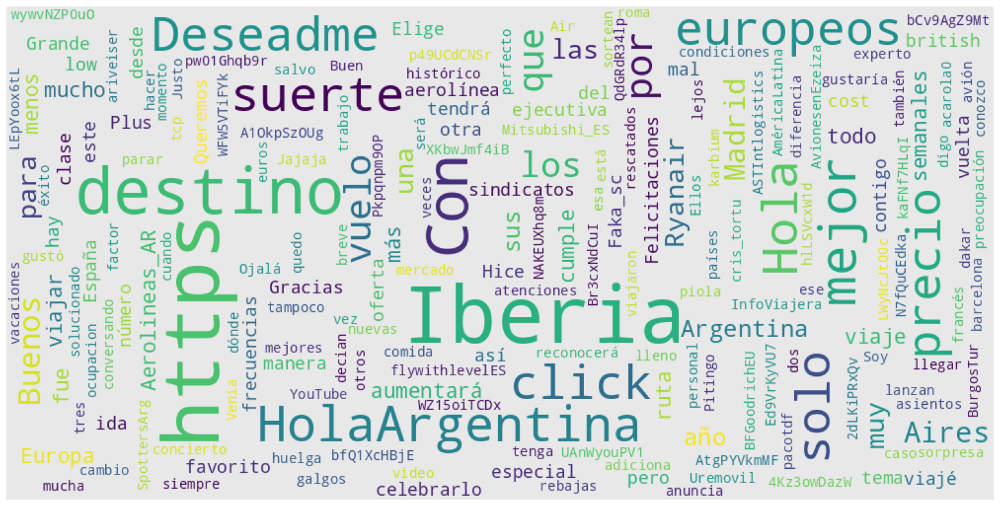

In [ ]:
df_aux = df_tweets[(df_tweets.location == "Buenos Aires") & (df_tweets.airline_sentiment == "positive")]
all_texts = " ".join(list(df_aux.text.values))

wordcloud = WordCloud(max_font_size=80, max_words=200, collocations=False,
                      width=1000, height=500, min_word_length=3,
                      background_color="#e8e8e8", margin=5, prefer_horizontal=0.5)

image = wordcloud.generate(all_texts)

plt.figure(figsize=[20,10])
plt.imshow(image)
plt.axis("off")
plt.show()

**Explicación del código**

- **Obtener datos**

  ```python
df_aux = df_tweets[(df_tweets.location == "Buenos Aires") & (df_tweets.airline_sentiment == "positive")]
all_texts = " ".join(list(df_aux.text.values))
```

  1. Se filtra el *dataset* para tener los _tweets_ de Buenos aires con sentimiento positivo.
  2. Luego, al *dataset* filtrado (`df_aux`), se hace `.text.values` para seleccionar la columna `text` y luego obtener los valores de dicha columna.
  3. Finalmente, se hace `list` para transformarlo en una lista de textos y `" ".join()`para unir todos los textos con un espacio. De este modo construimos 1 solo texto que le pasaremos a la nube de palabra.

- **Generar visualización**

  ```python
wordcloud = WordCloud(max_font_size=80, max_words=200, collocations=False,
                        width=1000, height=500, min_word_length=3,
                        background_color="#e8e8e8", margin=5, prefer_horizontal=0.5)
image = wordcloud.generate(all_texts)
```

  Primero, usamos el objeto [WordCloud](https://amueller.github.io/word_cloud/generated/wordcloud.WordCloud.html) para construir una planilla para la nube de palabra. Esta planilla presenta las siguientes configuraciones:
  - `max_font_size`: indica el tamaño máximo de las palabras.
  - `max_words`: indica la cantidad máxima a considerar en la nube de palabras.
  - `collocations`: indica si la nube de palabra debe incluir las colocaciones o no. Las colocaciones son conjunto de palabras (bigrama, trigrama, etc.) que siempre van juntos y tienen un significa en conjunto. Por ejemplo, Nueva York.
  - `width`: para indicar el ancho de la visualización.
  - `height`: para indicar el largo de la visualización.
  - `min_word_length`: para indicar el número de caracteres mínimo que debe tener las palabras.
  - `background_color`: para indicar el color de fondo.
  - `margin`: para indicar la distancia mínima entre una palabra y otra.
  - `prefer_horizontal`: para indicar el porcentaje de palabras que estarán horizontalmente y el resto no.

Finalmente, usamos `generate(all_texts)` para indicar a esta planilla con qué textos debe generar la imagen.

- **Mostrar visualización**

    ```python
plt.figure(figsize=[20,10])
plt.imshow(image)
plt.axis("off")
plt.show()
```
  Ahora usamos algunos métodos de matplotlib para ver la imagen en pantalla. Para esto:

  1. Le indicamos a matplotlib que genera un figura de 20x10 pulgadas donde pondremos la visualización.
  2. Luego usamos la función `imshow` para llenar la figura con la imagen que tiene `image` almacenada. En este caso, la visualización.
  3. Configuramos la figura de matplotlib para que no tenga ejes.
  4. Usamos `.show` para que muestre la figura en pantalla.

----

Ahora queremos generar la misma nube de palabras, pero sin tantos colores (solo grises) y todas horizontales.

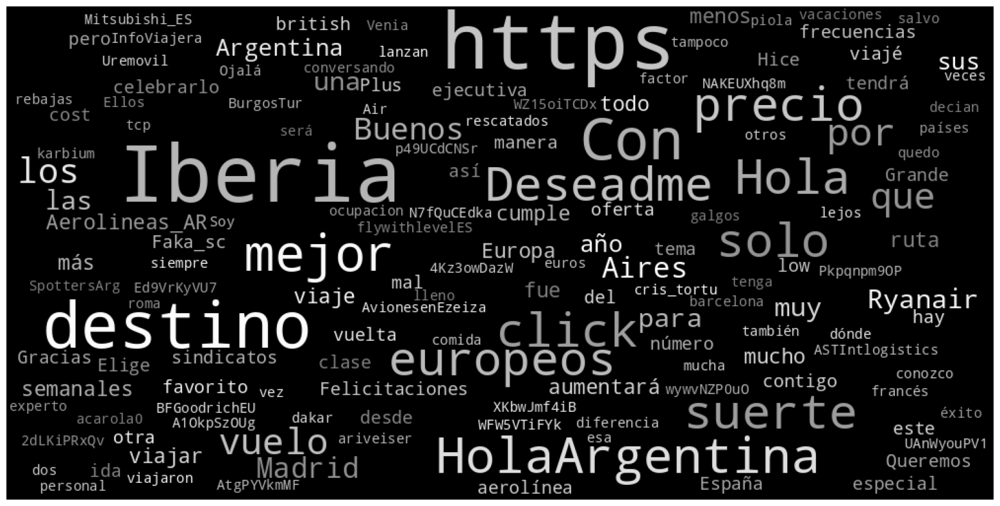

In [ ]:
wordcloud = WordCloud(max_font_size=80, max_words=150, collocations=False,
                      width=1000, height=500, min_word_length=3,
                      background_color="black", margin=5, prefer_horizontal=1)

image = wordcloud.generate(all_texts)

def grey_color(word, font_size, position, orientation, random_state=None, **kwargs):
    return "hsl(0, 0%, {}%)".format(random.randint(50, 100))

image.recolor(color_func=grey_color)

plt.figure(figsize=[20,10])
plt.imshow(image)
plt.axis("off")
plt.show()

**Explicación del código**

- **Modificar la visualización**
La nube de palabra se genera de la misma forma que antes. Solo hacemos 2 nuevos pasos:

  ```python
def grey_color(word, font_size, position, orientation, random_state=None, **kwargs):
      return "hsl(0, 0%, {}%)".format(random.randint(50, 100))
  ```
  Definimos una función `grey_color` que recibe una palabra, el tamaño de la palabra, su posición, orientación y cualquier otro parámetro que la librería _wordloud_ presente sobre cada palabra. En función de estos parámetros, se debe retornar un texto con el formato de algún color, puede ser HSL, HSV, color en hexadecimal, etc. De ese modo, el color se puede definir en función del tamaño de la palabra, según su orientación o según la palabra misma.

  En este caso, la función retorna siempre un texto con el formato de un color en HSL (hue, saturation, Lightness) en donde el _hue_ y saturación son 0, y la luminosidad es un número aleatorio entre 50 y 100. De este modo, se generan diferentes patrones de grises para cada palabra

  ```python
image.recolor(color_func=grey_color)
  ```

  Usando `recolor`, la nube de palabras vuelve a definir el color de cada palabra aplicando la función entregada.

----

¿Y si necesitamos que todas las palabras tengan un mismo color?

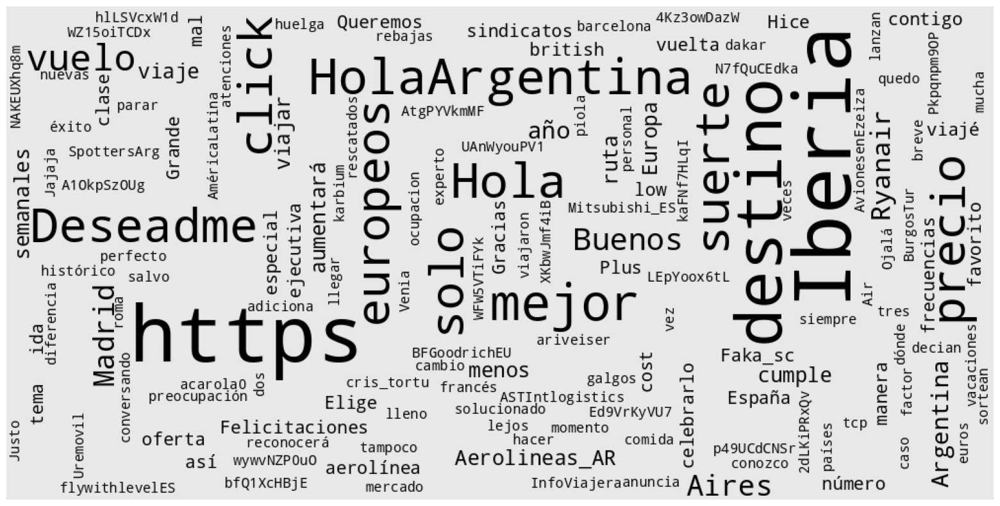

In [ ]:
wordcloud = WordCloud(max_font_size=80, max_words=150, collocations=False,
                      width=1000, height=500, stopwords=spanish_stopword, min_word_length=3,
                      background_color="#e8e8e8", margin=5, prefer_horizontal=0.5)

image = wordcloud.generate(all_texts)

def black_color(word, font_size, position, orientation, **kwargs):
    return "black"

image.recolor(color_func=black_color)

plt.figure(figsize=[20,10])
plt.imshow(image)
plt.axis("off")
plt.show()

**Explicación del código**

- **Modificar la visualización**

  ```python
def black_color(word, font_size, position, orientation, **kwargs):
      return "black"
  ```
En este caso, solo hicimos que la función siempre diga que el color será negro.

## Actividad 5 - Nube de palabra

Construya una nube de palabra considerando únicamente los *tweets* cuya localización es Madrid y presentan un sentimiento positivo o neutral, es decir, se desean analizar todo *tweets* **que no sea negativo**. Personalice la nube de palabra del siguiente modo:
1. Máximo incluya 100 palabras.
2. Tamaño máximo de fuente debe ser 100.
3. El margen entre las palabras debe ser 2.
4. Todas las palabras deben estar horizontal, es decir, la preferencia por palabras horizontales debe ser igual a 1.

In [ ]:
# # COMPLETAR
# df_aux = df_tweets
# all_texts = " ".join(list(df_aux.text.values))

# wordcloud = WordCloud()

# image = wordcloud.generate(all_texts)

# plt.figure(figsize=[20,10])
# plt.imshow(image)
# plt.axis("off")
# plt.show()

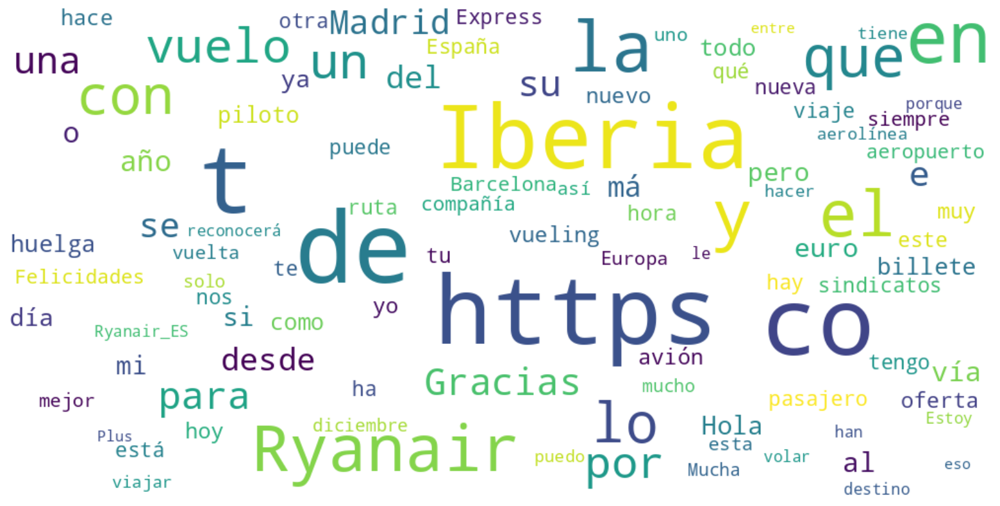

In [ ]:
# Filtramos los tweets de Madrid con sentimiento positivo o neutral
df_aux = df_tweets[(df_tweets.location == "Madrid") & (df_tweets.airline_sentiment.isin(["positive", "neutral"]))]

# Unimos todos los textos en una sola cadena
all_texts = " ".join(list(df_aux.text.values))

# Creamos la nube de palabras con las personalizaciones solicitadas
wordcloud = WordCloud(max_font_size=100,       # Tamaño máximo de fuente
                      max_words=100,           # Máximo de palabras
                      collocations=False,      # No incluir colocaciones
                      width=1000,              # Ancho de la nube de palabras
                      height=500,              # Altura de la nube de palabras
                      margin=2,                # Margen entre las palabras
                      prefer_horizontal=1,     # Todas las palabras horizontales
                      background_color="white" # Fondo blanco (opcional)
                      )

# Generamos la imagen de la nube de palabras
image = wordcloud.generate(all_texts)

# Visualizamos la nube de palabras
plt.figure(figsize=[20,10])
plt.imshow(image, interpolation="bilinear")
plt.axis("off")  # Ocultar los ejes
plt.show()

## Mini caso ML

En este caso, vamos a entrenar varios modelos capaces de detectar el sentimiento (negativo, positivo o neutral) a partir de las palabras. Para esto, vamos a transformar cada texto en un vector con TF-IDF y luego le entregaremos ese vector al modelo.

In [ ]:
# Dividir datos en train y test.
train, test, target_train, target_test = train_test_split(df_tweets.text_processed,
                                                          df_tweets.airline_sentiment,
                                                          test_size=0.3)

# Crear Vectorizador TF-IDF
tf_idf = TfidfVectorizer(max_df=0.9, strip_accents='ascii')

# Entrenar vectorizador con datos de test y generar X_train, donde cada texto se transformó en un vector
X_train = tf_idf.fit_transform(train)

# Transformar los textos de test en un vector
X_test = tf_idf.transform(test)

Partiremos entrenando un [árbol de decisión](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html#sklearn.tree.DecisionTreeClassifier).

In [ ]:
# Crear modelo
model = DecisionTreeClassifier(criterion="gini", min_samples_split=10, max_features=50, max_leaf_nodes=100)

# Entrenar modelo
model.fit(X_train, target_train)

# Predecir el sentimiento de los textos de test
tree_y_predict = model.predict(X_test)

# Ver resumen de los resultados
print(classification_report(target_test, tree_y_predict))

              precision    recall  f1-score   support

    negative       0.57      0.70      0.62       733
     neutral       0.38      0.40      0.39       523
    positive       0.46      0.18      0.26       311

    accuracy                           0.50      1567
   macro avg       0.47      0.43      0.43      1567
weighted avg       0.49      0.50      0.48      1567



Probemos ahora con un [RandomForest](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html).

In [ ]:
# Crear modelo
model = RandomForestClassifier(n_estimators=200, min_samples_split=10, max_features=50, max_leaf_nodes=100)

# Entrenar modelo
model.fit(X_train, target_train)

# Predecir el sentimiento de los textos de test
forest_y_predict = model.predict(X_test)

# Ver resumen de los resultados
print(classification_report(target_test, forest_y_predict))

              precision    recall  f1-score   support

    negative       0.55      0.89      0.68       733
     neutral       0.45      0.25      0.32       523
    positive       0.54      0.16      0.25       311

    accuracy                           0.53      1567
   macro avg       0.52      0.44      0.42      1567
weighted avg       0.52      0.53      0.48      1567



Finalmente, probemos con Máquinas de vectores de soporte (SVM). Aunque en este caso es [SVC porque es (Support Vector Classification)](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html#sklearn.svm.SVC).

In [ ]:
# Crear modelo
model = SVC(kernel="rbf", C=2, gamma=1.2)

# Entrenar modelo
model.fit(X_train, target_train)

# Predecir el sentimiento de los textos de test
svc_y_predict = model.predict(X_test)

# Ver resumen de los resultados
print(classification_report(target_test, svc_y_predict))

              precision    recall  f1-score   support

    negative       0.62      0.77      0.69       733
     neutral       0.47      0.42      0.44       523
    positive       0.47      0.26      0.33       311

    accuracy                           0.56      1567
   macro avg       0.52      0.49      0.49      1567
weighted avg       0.54      0.56      0.54      1567



Tras entrenar los 3 modelos y observar que el `SVC` fue el mejor entre los 3, vamos a visualizar una nube de palabras para los textos que este modelo identificó como negativo. Para esto, primero construimos un pequeño DataFrame con los textos y el sentimiento entregado por el modelo.

In [ ]:
df_aux = pd.DataFrame({"text": test.values, "sentiment": svc_y_predict})
df_aux = df_aux[df_aux.sentiment == "negative"]
df_aux.head()

,text,sentiment
2,iberia entonces hacemos check in online acepta...,negative
4,iberia iberiaen iberiapromos iberia perdió mal...,negative
5,dejan ruta salga,negative
6,personal tierra ryanair paros vía,negative
7,ryanair,negative


Ahora construimos nuestra nube de palabras.

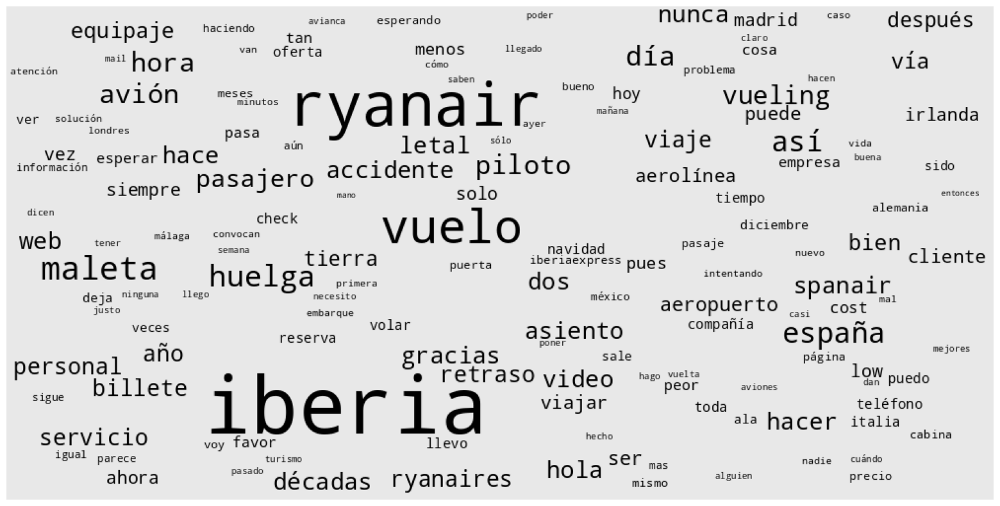

In [ ]:
all_texts = " ".join(list(df_aux.text.values))
wordcloud = WordCloud(max_font_size=80, max_words=150, collocations=False,
                      width=1000, height=500, stopwords=spanish_stopword, min_word_length=3,
                      background_color="#e8e8e8", margin=5, prefer_horizontal=1)

image = wordcloud.generate(all_texts)

def black_color(word, font_size, position, orientation, **kwargs):
    return "black"

plt.figure(figsize=[20,10])
plt.imshow(image.recolor(color_func=black_color))
plt.axis("off")
plt.show()

### Actividad 6 - Comentario

Comente respecto a la visualización creada. Su comentario como mínimo debe responder la siguiente pregunta:
- ¿Tiene sentido la visualización creada? ¿hay palabras que reflejen el sentimiento negativo? Justifique su respuesta.



*   **Respuesta**:


La visualización de la nube de palabras generada a partir de los tweets identificados como negativos por el modelo SVC tiene sentido en el contexto del análisis de sentimiento. Al observar las palabras destacadas, se puede notar que términos como "accidente," "letal," y "retraso" se presentan en un tamaño medio, lo que indica que son más frecuentes en los textos clasificados como negativos. Estas palabras reflejan claramente un sentimiento negativo, ya que se asocian con situaciones desfavorables y preocupaciones de los pasajeros.

Además, palabras como "mal," "problema," "peor," y "ninguna," aunque están en un tamaño más pequeño, también aportan al sentimiento negativo general. Estos términos reflejan insatisfacción y frustración por parte de los usuarios con respecto a la aerolínea. En general, la visualización efectivamente capta la esencia de los sentimientos negativos en los tweets analizados, permitiendo identificar de manera visual los aspectos problemáticos que los pasajeros desean destacar en sus experiencias.

Finalmente podemos comentar que sobre los términos relacionados con aerolíneas, como "Ryanair," "vuelo," e "Iberia," aparecen en tamaño grande, lo que sugiere que los pasajeros están claramente expresando sus sentimientos hacia estas compañías.

**Comentario**: Completar.

### Actividad 7 - Uso de modelos

1. Entrene un modelo de clasificación y prediga el sentimiento de los textos de test. **Importante**: en caso de usar alguno de los modelos utilizados en el ejemplo (`DecisionTreeClassifier`, `RandomForestClassifier` o `SVC`), **debe** cambiar sus parámetros para que no sea exactamente el mismo modelo que el utilizado en el ejemplo.
2. Imprima los resultados con `classification_report`.
3. Construya una nube de palabras utilizando únicamente los textos que su modelo clasificó como negativos.
4. Comente sobre los resultados y la visualización confeccionada. Su comentario debe responder al menos las siguientes 2 preguntas:
    - ¿Cómo cree que le fue a su modelo? Esta respuesta se debe apoyar en los resultados numéricos y/o de la visualización.
    - ¿Tiene sentido la visualización creada? ¿hay palabras que reflejen el sentimiento negativo? Justifique su respuesta.

In [ ]:
# Completar

**Cambios realizados**

*   n_estimators: Cambiado a 150, lo que puede mejorar la estabilidad del modelo.
*   min_samples_split: Cambiado a 5, para que el árbol no se divida hasta que haya al menos 5 muestras.
*   max_features: Cambiado a 'sqrt', lo que hace que el modelo use una raíz cuadrada del número total de características en cada división.
*   max_leaf_nodes: Cambiado a 50 para limitar la complejidad del modelo.



In [ ]:
# Importar librerías necesarias
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# df_tweets es nuestrp DataFrame ya preparado

# Dividimos los datos en train y test.
train, test, target_train, target_test = train_test_split(df_tweets.text_processed,
                                                          df_tweets.airline_sentiment,
                                                          test_size=0.3,
                                                          random_state=42)  # Fijar la aleatoriedad

# Creamos Vectorizacion TF-IDF
tf_idf = TfidfVectorizer(max_df=0.85, strip_accents='unicode')  # Cambiar max_df a 0.85

# Entrenamos vectorizador con datos de train y generar X_train
X_train = tf_idf.fit_transform(train)

# Transformamos los textos de test en un vector
X_test = tf_idf.transform(test)

# Se crea un modelo de RandomForest con parámetros modificados
model = RandomForestClassifier(n_estimators=150, min_samples_split=5, max_features='sqrt', max_leaf_nodes=50)  # Modificar los parámetros

# Entrenar modelo
model.fit(X_train, target_train)

# Predecir el sentimiento de los textos de test
forest_y_predict = model.predict(X_test)

In [ ]:
# Ver resumen de los resultados
print(classification_report(target_test, forest_y_predict))

              precision    recall  f1-score   support

    negative       0.52      0.94      0.67       724
     neutral       0.50      0.19      0.28       525
    positive       0.61      0.12      0.20       318

    accuracy                           0.52      1567
   macro avg       0.55      0.42      0.38      1567
weighted avg       0.53      0.52      0.45      1567



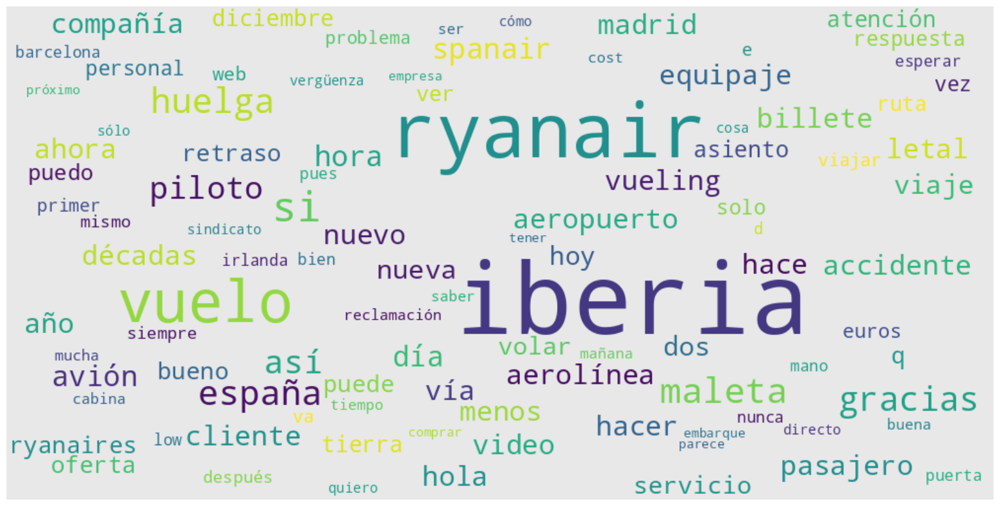

In [ ]:
# Importar librerías necesarias
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Crear un DataFrame con los textos y el sentimiento entregado por el modelo
df_aux = pd.DataFrame({"text": test, "sentiment": forest_y_predict})  # Asegúrate de que `test` contenga los textos originales
df_aux = df_aux[df_aux.sentiment == "negative"]  # Filtrar solo los negativos

# Unir todos los textos negativos en una sola cadena
all_texts = " ".join(list(df_aux.text.values))

# Crear la nube de palabras
wordcloud = WordCloud(max_font_size=100, max_words=100,
                      collocations=False, width=1000, height=500,
                      background_color="#e8e8e8", margin=5,
                      prefer_horizontal=1).generate(all_texts)

# Visualizar la nube de palabras
plt.figure(figsize=[20,10])
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")  # No mostrar los ejes
plt.show()


**Comentario**: recuerde que este debe incluir respuesta a las siguientes 2 preguntas:
- ¿Cómo cree que le fue a su modelo? Puede apoyarse de los resultados numéricos y/o de la visualización.
- ¿Tiene sentido la visualización creada? ¿hay palabras que reflejen el sentimiento negativo? Justifique su respuesta.


 1. Respuesta 1

Los resultados del modelo muestran un rendimiento mixto.

*   En términos de precisión, el modelo tuvo un 52% de precisión general, lo que indica que aproximadamente la mitad de las predicciones fueron correctas.
*   El recall para la clase negativa fue notablemente alto (94%), lo que significa que el modelo fue muy efectivo para identificar textos negativos, pero esto también podría indicar que el modelo está sesgado hacia esta clase.
*   El f1-score para la clase negativa fue de 0.67, lo que sugiere un equilibrio moderado entre precisión y recall, aunque no es un rendimiento sobresaliente.
*   El recall para la clase neutral fue solo del 19%, lo que indica que muchos textos neutrales fueron clasificados incorrectamente
*   El f1-score para la clase positiva es bastante bajo (0.20), lo que indica que el modelo tiene dificultades para identificar correctamente las opiniones positivas.
*   El modelo parece ser eficiente para detectar el sentimiento negativo, pero tiene un desempeño deficiente en las clases neutral y positiva.

 2. Respuesta 2

Sí, la visualización tiene sentido en el contexto del análisis de sentimientos.

*   Las palabras más grandes, como "Iberia," "Ryanair," y "vuelo," reflejan marcas y conceptos que son relevantes en el contexto de las quejas sobre aerolíneas.
*   Las palabras de tamaño mediano, como "huelga," "maleta," "accidente," y "compañía," claramente transmiten sentimientos negativos relacionados con experiencias de viaje desfavorables. Estas palabras indican problemas específicos, como huelgas y accidentes, que son temas de descontento en el ámbito del transporte aéreo.
*   Las palabras más pequeñas, como "viajar" y "sindicato," también pueden estar relacionadas con sentimientos negativos, aunque no son tan destacables.
*   La visualización efectivamente captura el sentimiento negativo que se refleja en las palabras analizadas, mostrando términos que indican descontento y quejas sobre el servicio y las experiencias de viaje.

## Extra - No nos condicionemos a librerías



Un problema muy común hoy en día es que uno/a se condiciona a construir visualizaciones siempre y cuando alguna librería lo permita de forma sencilla. Sin embargo, con un poco de creatividad y conocimientos de Matplotlib (una de las librerías de visualización de más bajo nivel), podemos construir nuestra propia visualización que las librerías todavía no ofrezcan.

A continuación vamos a construir una visualización que ayude a identificar palabras en un texto que tienen asociado un valor positivo y aquellas que tengan asociado un valor negativo. Para esto, la visualización se encargará de pintar el color de fondo de las palabras en función del valor asociado a dicha palabra.


Primero vamos a definir ciertas variables y funciones importantes:
- `positive_tf_idf`: Vectorizador encargado de obtener el valor TF-IDF de un texto. Solo fue entrenado con _tweets_ **positivos**.
- `negative_tf_idf`: Vectorizador encargado de obtener el valor TF-IDF de un texto. Solo fue entrenado con _tweets_ **negativos**.
- `get_tfidf_for_words(text, tf-idf)`: función que recibe un texto, un vectorizador y se encarga de aplicar dicho vectorizador al texto y luego extraer el peso específico de cada palabra. Por ejemplo:
```python
print(get_tfidf_for_words("Hola estoy feliz", positive_tf_idf))
> {'estoy': 0.6527310362012407, 'feliz': 0.6039980978676813, 'hola': 0.4573056878630286}
```
- `get_weight(text)` recibe un texto y retorna una lista con un peso asociado a cada palabra del texto. Para esto, la función utiliza ambos vectorizadores (`positive_tf_idf` y `negative_tf_idf`) para obtener el peso de cada palabra desde una mirada positiva y otra negativa. Luego, se selecciona el peso que presenta el mayor valor absoluto. Finalmente, para aquellos pesos que provengan del `negative_tf_idf`, se multiplican por -1 para dar énfasis que dicha palabra tiene un peso asociado a un sentimiento negativo. Por ejemplo:
```python
print(get_weight("fue un pesimo servicio"))
> [0.6647159936473204, 0.3410356221553861, -0.765328222995469, 0.6647159936473204]
```

In [ ]:
positive_tf_idf = TfidfVectorizer(max_df=0.9, strip_accents='ascii')
positive_tf_idf.fit(df_tweets[df_tweets.airline_sentiment == 'positive'].text)

negative_tf_idf = TfidfVectorizer(max_df=0.9, strip_accents='ascii')
negative_tf_idf.fit(df_tweets[df_tweets.airline_sentiment == 'negative'].text)

def get_tfidf_for_words(text, tfidf):
    tfidf_matrix= tfidf.transform([text.lower()]).todense()
    feature_index = tfidf_matrix[0,:].nonzero()[1]
    feature_names = tfidf.get_feature_names_out()
    tfidf_scores = zip([feature_names[i] for i in feature_index], [tfidf_matrix[0, x] for x in feature_index])
    return dict(tfidf_scores)

def get_weight(text):
    positive_weight = get_tfidf_for_words(text, positive_tf_idf)
    negative_weight = get_tfidf_for_words(text, negative_tf_idf)
    weights = []
    for x in text.lower().split():
        pos_value = positive_weight.get(x, 0)
        neg_value = negative_weight.get(x, 0)
        if abs(pos_value) > abs(neg_value):
            weights.append(pos_value)
        else:
            weights.append(-1 * neg_value)
    return weights

print("pos: ", get_tfidf_for_words("estoy feliz", positive_tf_idf))
print("neg: ", get_tfidf_for_words("estoy molesto", negative_tf_idf))
print(get_weight("fue un pesimo servicio"))

pos:  {'estoy': 0.7339750517056336, 'feliz': 0.6791764302990149}
neg:  {'estoy': 0.5372494559640956, 'molesto': 0.8434233943081514}
[0.6595300493181872, 0.34312724576103165, -0.6905873867173713, 0.6687927984531521]


Ahora vamos a definir una función `colorize` que recibe un texto y una lista de pesos. Esta función normaliza los pesos entre 0 y 1, luego los mapea a un color de una escala **bidireccional** ([RdBu](https://loading.io/color/feature/RdBu-7/)). Finalmente, crea un pequeño HTML en donde el color de fondo de palabra se define en función del peso entregado.

In [ ]:
def colorize(text, weights):
    min_value = min(weights)
    max_value = max(weights)
    color_array = [(x - min_value)/(max_value - min_value) for x in weights]
    cmap = matplotlib.colormaps.get_cmap('RdBu')
    template = '<span style="color: {}; background-color: {}; padding: 2px; margin: 2px; font-size: 18px">{}</span>'
    colored_string = ''
    for word, color in zip(text.split(), color_array):
        color_back = matplotlib.colors.rgb2hex(cmap(color)[:3])
        color_text = "black"
        if color < 0.2 or color > 0.8:
            color_text = "white"
        colored_string += template.format(color_text, color_back, word)
    return colored_string

In [ ]:
doc = df_tweets.iloc[3] # Puede cambiar el 3 por un número entre 0 y 5220 inclusive.
print("Sentimiento: ", doc.airline_sentiment, "\n")
weights = get_weight(doc.text)
display(HTML(colorize(doc.text, weights)))

Sentimiento:  negative 



# Links de interés

- [Más ejemplos de Plugins de Folium](https://python-visualization.github.io/folium/latest/user_guide/plugins.html). Si no se ven los mapas en el link, visitar [este Colab](https://colab.research.google.com/drive/1JqTwUm5QZtVdXEuG4Bf0SXSBH_qGmGj8), hacer una copia y ejecutar.
- [Más ejemplos de WordCloud](https://www.datacamp.com/tutorial/wordcloud-python).
- Otras librerías para generación de mapas:
    - [Geopandas](https://geopandas.org/en/stable/gallery/index.html).
    - [Plotly](https://plotly.com/python/maps/).
    - [Geoplot](https://residentmario.github.io/geoplot/index.html).
    

- [Kepler.gl](https://kepler.gl/): aplicación web para visualización de datos espaciales sin necesidad de código.